<a href="https://colab.research.google.com/github/NTHue/The-SQL-Workshop/blob/master/VEF_DA_2001_Python_online_session_Housing_Price_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
!pip install gmplot geopy

In [0]:
!pip uninstall pandas-profiling

Uninstalling pandas-profiling-2.8.0:
  Would remove:
    /usr/local/bin/pandas_profiling
    /usr/local/lib/python3.6/dist-packages/pandas_profiling-2.8.0.dist-info/*
    /usr/local/lib/python3.6/dist-packages/pandas_profiling/*
Proceed (y/n)? y
  Successfully uninstalled pandas-profiling-2.8.0


In [0]:
!pip install pandas-profiling[notebook,html]

  Using cached https://files.pythonhosted.org/packages/b9/94/ef8ef4517540d13406fcc0b8adfd75336e014242c69bd4162ab46931f36a/pandas_profiling-2.8.0-py2.py3-none-any.whl


In [0]:
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt
# import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import gmplot 
import pandas_profiling as pp

In [0]:
df = pd.read_csv ("https://github.com/Shreyas3108/house-price-prediction/blob/master/kc_house_data.csv?raw=true")

In [0]:
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [0]:
df.shape

(21613, 21)

<Figure size 720x720 with 0 Axes>

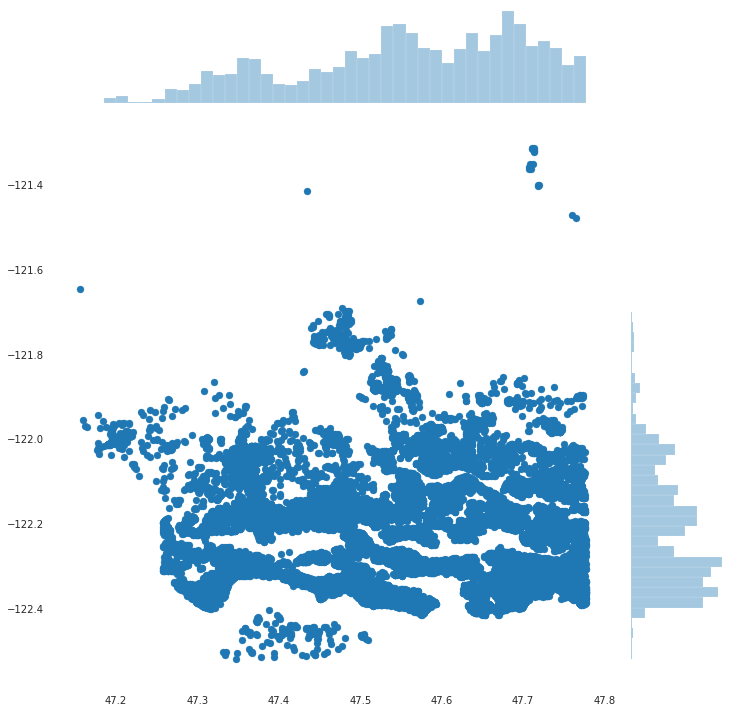

In [0]:
plt.figure (figsize= (10,10))
sns.jointplot (x = df.lat.values, y = df.long.values, height = 10)
plt.show ()

In [0]:
gmap3 = gmplot.GoogleMapPlotter(center_lat = np.mean (df.lat.values),
                                center_lng = np.mean (df.long.values),
                                zoom = 13) 
  
# scatter method of map object  
# scatter points on the google map 
gmap3.scatter(df.lat.values, df.long.values, '# FF0000',
                              size = 40, marker = False ) 
  
# Plot method Draw a line in 
# between given coordinates 
gmap3.plot(df.lat.values, df.long.values,  
           'cornflowerblue', edge_width = 2.5) 
gmap3.draw ("housing.html")

In [0]:
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="demo")
location = geolocator.reverse(str(df.lat[0]) + ',' + str(df.long[0]))
print (location.address)

10012, 61st Avenue South, Rainier Beach, Tamill, Seattle, King County, Washington, 98178, United States of America


In [0]:
from pandas_profiling import ProfileReport
profile = ProfileReport(df, title = "Report", explorative=True)
profile

In [0]:
df['date'] = pd.to_datetime (df['date'])

In [0]:
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503
